# K-means for color compression 



## Objective

We will use K-means to cluster the pixels of a photograph based on their encoded color values. We will explore how different values of _k_ affect the clustering of the pixels, and thus the appearance of the photograph.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

%pylab inline
import plotly.graph_objects as go

from sklearn.cluster import KMeans

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from PIL import Image
import requests
from io import BytesIO

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


## Read in data

The data is a photograph, which we'll convert into a numerical array.

In [2]:
# URL image
url = "https://images.unsplash.com/photo-1705862667646-54de4f9fe1fe?w=800&auto=format&fit=crop&q=60&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHx0b3BpYy1mZWVkfDIwNHx4alBSNGhsa0JHQXx8ZW58MHx8fHx8"

# Fetch the image
response = requests.get(url)
img = Image.open(BytesIO(response.content))

# Resize the image
#img_resized = img.resize((320, 240)) # landscape
img_resized = img.resize((240, 320))  # vertical

# Save/display the image
img_resized.show()  
img_resized.save("images_input/resized_image_from_url.jpg")

In [3]:
# Read in a photo 
img = plt.imread('images_input/resized_image_from_url.jpg')

(320, 240, 3)


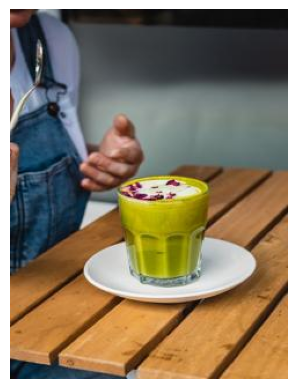

In [4]:
# Display the photo and its shape
print(img.shape)
plt.imshow(img)
plt.axis('off');

Here we have a photograph of a matcha latte from your local café ;-) 

The shape of the image is 320 x 240 x 3. This is pixel information. Each dot on your screen is a pixel. This photograph has 320 vertical pixels and 240 horizontal pixels. 

The dimension "3" refers to the values that encode the color of each pixel. Each pixel has 3 parameters: red (R), green (G), and blue (B), also known as its RGB values. For each color—R, G, and B—the encoded value can range from 0-255. This means that there are $256^3$, or $16777216$ different combinations of RGB, each resulting in a unique color on your screen. 

To prepare this data for modeling, we'll reshape it into an array, where each row represents a single pixel's RGB color values. 

In [5]:
# Reshape the image so that each row represents a single pixel defined by three values: R, G, B
img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
img_flat[:10, :]

array([[52, 28, 16],
       [50, 26, 14],
       [47, 24, 16],
       [47, 24, 18],
       [48, 24, 20],
       [48, 24, 22],
       [44, 22, 24],
       [43, 21, 23],
       [43, 18, 21],
       [42, 18, 18]], dtype=uint8)

In [6]:
img_flat.shape

(76800, 3)

## Plot the data in 3D space

Now we have an array that is 76,800 x 3. Each row is a single pixel's color values. Because we have only 3 columns, we can visualize this data in 3-dimensional space. Let's create a pandas dataframe to help us understand and visualize our data.

In [7]:
# Create a pandas df with r, g, and b as columns
img_flat_df = pd.DataFrame(img_flat, columns = ['r', 'g', 'b'])

img_flat_df.head(10)

,r,g,b
0,52,28,16
1,50,26,14
2,47,24,16
3,47,24,18
4,48,24,20
5,48,24,22
6,44,22,24
7,43,21,23
8,43,18,21
9,42,18,18


In [8]:
img_flat_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76800 entries, 0 to 76799
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   r       76800 non-null  uint8
 1   g       76800 non-null  uint8
 2   b       76800 non-null  uint8
dtypes: uint8(3)
memory usage: 225.1 KB


In [9]:
# Create 3D plot where each pixel in the `img` is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for r,g,b 
                                        in zip(img_flat_df.r.values, 
                                               img_flat_df.g.values, 
                                               img_flat_df.b.values)],
                                 opacity=0.5))

data = [trace]

camera = dict(
    eye=dict(x=0, y=2, z=0), # adjust
    center=dict(x=0, y=0, z=0),
    up=dict(x=0, y=0, z=1)
)

layout = go.Layout(
    margin=dict(l=0, r=0, b=0, t=0),
    scene=dict(camera=camera)
)

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )

fig.write_image('output/scatter3d_pixel_color.png')
fig.show()

In this graph, each dot represents a color/pixel that is in our original image. The more intense the color, the more dots are concentrated in that area. The most-represented colors in the graph are the most abundant colors in the photograph.

We can train a K-means model on this data. The algorithm will create _k_ clusters by minimizing the squared distances from each point to its nearest centroid. 

Let's first do an experiment. Let's built a K-means model with just a single centroid (_k_ = 1) and replace each pixel in the photograph with the RGB value.

## Cluster the data: _k_ = 1

In [10]:
# Instantiate the model
kmeans = KMeans(n_clusters=1, random_state=42).fit(img_flat)

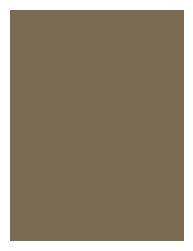

In [11]:
# Copy `img_flat` so we can modify it
img_flat1 = img_flat.copy()

# Replace each row in the original image with its closest cluster center
for i in np.unique(kmeans.labels_):
    img_flat1[kmeans.labels_==i,:] = kmeans.cluster_centers_[i]

# Reshape the data back to (640, 480, 3)
img1 = img_flat1.reshape(img.shape)

plt.figure(figsize=(4,3))
plt.imshow(img1)
plt.axis('off');

Let's run through the K-means steps:

1. We randomly placed our centroid in the colorspace.
2. We assigned each point to its nearest centroid. Since there was only one centroid, all points were assigned to the same centroid, and thus to the same cluster.
3. We updated the centroid's location to the mean location of all of its points. Again, since there is only a single centroid, it updated to the mean location of every point in the image.
4. Repeat until the model converges. In this case, it only took one iteration for the model to converge. 

We then updated each pixel's RGB values to be the same as the centroid's. The result is the image of our tulips when every pixel is replaced with the average color. The average color of this photo was brown⁠—all the colors muddled together.

We can verify this for ourselves by manually calculating the average for each column in the flattened array. This will give us the average R value, G value, and B value. 

In [12]:
# Calculate mean of each column in the flattened array
column_means = img_flat.mean(axis=0)

print('column means: ', column_means)

column means:  [121.72723958 106.82957031  82.25513021]


We can compare this to what the K-means model calculated as the final location of its one centroid.

In [13]:
print('cluster centers: ', kmeans.cluster_centers_)

cluster centers:  [[121.72723958 106.82957031  82.25513021]]


They're the same :-)

Let's return to the 3D rendering of our data, only this time we'll add the centroid.

In [14]:
# Create 3-D plot where each pixel in the `img` is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for 
                                        r,g,b in zip(img_flat_df.r.values, 
                                                     img_flat_df.g.values, 
                                                     img_flat_df.b.values)],
                                 opacity=0.5))

data = [trace]

camera = dict(
    eye=dict(x=0, y=2, z=0), # adjust
    center=dict(x=0, y=0, z=0),
    up=dict(x=0, y=0, z=1)
)

layout = go.Layout(
    margin=dict(l=0, r=0, b=0, t=0),
    scene=dict(camera=camera),
    annotations=[
        dict(
            text="Cluster k=1, centroid (black)",
            x=0.5,  
            y=1.0, 
            showarrow=False,
            font=dict(size=20)
        )
    ]
)

fig = go.Figure(data=data, layout=layout)

# Add centroid to chart
centroid = kmeans.cluster_centers_[0].tolist()

fig.add_trace(
    go.Scatter3d(x = [centroid[0]],
                 y = [centroid[1]],
                 z = [centroid[2]],
                 mode='markers',
                 marker=dict(size=7,
                             color='black',
                             opacity=1))
)
fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )

fig.write_image('output/scatter3d_pixel_color_centroid.png')
fig.show()

We can see the centroid as a large circle in the middle of the colorspace. Notice that this is the "center of gravity" of all the points in the graph.

Let's refit a K-means model to the data, this time using _k_ = 3.

## Cluster the data: _k_ = 3

In [15]:
# Instantiate k-means model for 3 clusters
kmeans3 = KMeans(n_clusters=3, random_state=42).fit(img_flat)

# Check the unique values of what's returned by the .labels_ attribute 
np.unique(kmeans3.labels_)

array([0, 1, 2], dtype=int32)

The `.cluster_centers_` attribute returns an array where each element represents the coordinates of a centroid (i.e., their RGB values). We'll use these coordinates as we did previously to generate the colors that are represented by our centroids.

In [16]:
# Assign centroid coordinates to `centers` variable
centers = kmeans3.cluster_centers_

centers1 = centers[0].tolist()
centers2 = centers[1].tolist()
centers3 = centers[2].tolist()

centers

array([[180.74540763, 131.75819309,  60.1234644 ],
       [147.18807362, 153.50891079, 152.82484339],
       [ 53.71005291,  53.6354828 ,  53.20257937]])

Now we'll create a helper function to easily display RGB values as color swatches, and use it to check the colors of the model's centroids.

In [17]:
# Helper function that creates color swatches
def show_swatch(RGB_value):
    '''
    Takes in an RGB value and outputs a color swatch
    '''
    R, G, B = RGB_value
    rgb = [[np.array([R,G,B]).astype('uint8')]]
    plt.figure(figsize=(4,3))
    plt.imshow(rgb)
    plt.axis('off');

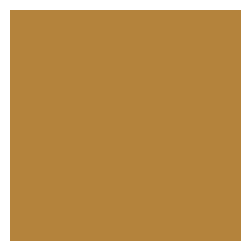

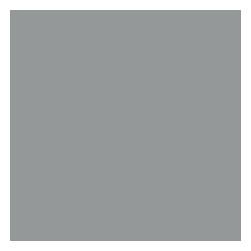

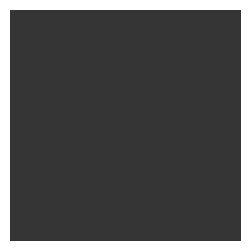

In [18]:
# Display the color swatches
for pixel in centers:
    show_swatch(pixel)

It's apparent that there are generally three dominant colors: reds, greens, and golds/yellows, which is very close to what the model returned.

Just as before, let's now replace each pixel in the original image with the RGB value of the centroid to which it was assigned.

In [19]:
# Helper function to display our photograph when clustered into k clusters
def cluster_image(k, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image.

    Args:
      k:    (int)          - Your selected K-value
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      The output of plt.imshow(new_img), where new_img is a new numpy array \
      where each row of the original array has been replaced with the \ 
      coordinates of its nearest centroid.
    '''

    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters = k, random_state = 42).fit(img_flat)
    new_img = img_flat.copy()
  
    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_ == i, :] = kmeans.cluster_centers_[i]
  
    new_img = new_img.reshape(img.shape)

    return plt.imshow(new_img), plt.axis('off'), plt.title('k=3'), plt.savefig('output/image_output_k3.png');
  

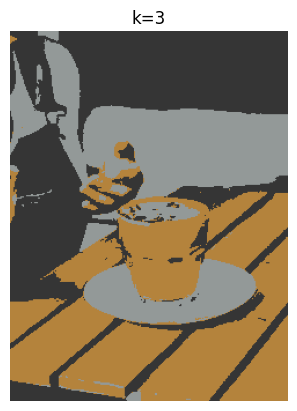

In [20]:
# Generate image when k=3
cluster_image(3);

We now have a photo with just three colors. Each pixel's RGB values correspond to the values of its nearest centroid. 

We can return once more to our 3-D colorspace. This time, we'll re-color each dot in the colorspace to correspond with the color of its centroid. This will allow us to see how the K-means algorithm clustered our data spatially.

In [21]:
# Just to get an understanding of what the data structures look like

print(kmeans3.labels_.shape)
print(kmeans3.labels_)
print(np.unique(kmeans3.labels_))
print(kmeans3.cluster_centers_)

(76800,)
[2 2 2 ... 0 0 0]
[0 1 2]
[[180.74540763 131.75819309  60.1234644 ]
 [147.18807362 153.50891079 152.82484339]
 [ 53.71005291  53.6354828   53.20257937]]


In [22]:
# Create a new column in the df that indicates the cluster number of each row 
# (as assigned by Kmeans for k=3)
img_flat_df['cluster'] = kmeans3.labels_
img_flat_df.head()

,r,g,b,cluster
0,52,28,16,2
1,50,26,14,2
2,47,24,16,2
3,47,24,18,2
4,48,24,20,2


In [23]:
# Create helper dictionary to map RGB color values to each observation in df
series_conversion = {0: 'rgb' +str(tuple(kmeans3.cluster_centers_[0])),
                     1: 'rgb' +str(tuple(kmeans3.cluster_centers_[1])),
                     2: 'rgb' +str(tuple(kmeans3.cluster_centers_[2])),
                     }
series_conversion

{0: 'rgb(180.74540763275303, 131.75819309122997, 60.12346439712189)',
 1: 'rgb(147.1880736172502, 153.50891079492874, 152.8248433933889)',
 2: 'rgb(53.710052910041185, 53.63548280422769, 53.20257936508164)'}

In [24]:
# Replace the cluster numbers in the 'cluster' col with formatted RGB values 
# (made ready for plotting)
img_flat_df['cluster'] = img_flat_df['cluster'].map(series_conversion)
img_flat_df.head()

,r,g,b,cluster
0,52,28,16,"rgb(53.710052910041185, 53.63548280422769, 53...."
1,50,26,14,"rgb(53.710052910041185, 53.63548280422769, 53...."
2,47,24,16,"rgb(53.710052910041185, 53.63548280422769, 53...."
3,47,24,18,"rgb(53.710052910041185, 53.63548280422769, 53...."
4,48,24,20,"rgb(53.710052910041185, 53.63548280422769, 53...."


In [25]:
# Replot the data, now showing which cluster (i.e., color) it was assigned to by K-means when k=3

trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=img_flat_df.cluster,
                                 opacity=1))

data = trace

camera = dict(
    eye=dict(x=0, y=2, z=0), # adjust
    center=dict(x=0, y=0, z=0),
    up=dict(x=0, y=0, z=1)
)

layout = go.Layout(
    margin=dict(l=0, r=0, b=0, t=0),
    scene=dict(camera=camera),
    annotations=[
        dict(
            text="Cluster k=3, centroids (black)",
            x=0.5,  
            y=1.0, 
            showarrow=False,
            font=dict(size=20)
        )
    ]
)

fig = go.Figure(data=data, layout=layout)

fig.add_trace(
    go.Scatter3d(x = [centers1[0]],
                 y = [centers1[1]],
                 z = [centers1[2]],
                 mode='markers',
                 marker=dict(size=7,
                             color='black',
                             opacity=1))
)
fig.add_trace(
    go.Scatter3d(x = [centers2[0]],
                 y = [centers2[1]],
                 z = [centers2[2]],
                 mode='markers',
                 marker=dict(size=7,
                             color='black',
                             opacity=1))
)
fig.add_trace(
    go.Scatter3d(x = [centers3[0]],
                 y = [centers3[1]],
                 z = [centers3[2]],
                 mode='markers',
                 marker=dict(size=7,
                             color='black',
                             opacity=1))
)

fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )


fig.write_image('output/scatter3d_cluster_k3.png')
fig.show()

K-means successfully compresses the colors of this photograph. This process can be applied for any value of _k_. Here's the output of each photo for _k_ = 2–10.

## Cluster the data: _k_ = 2-10

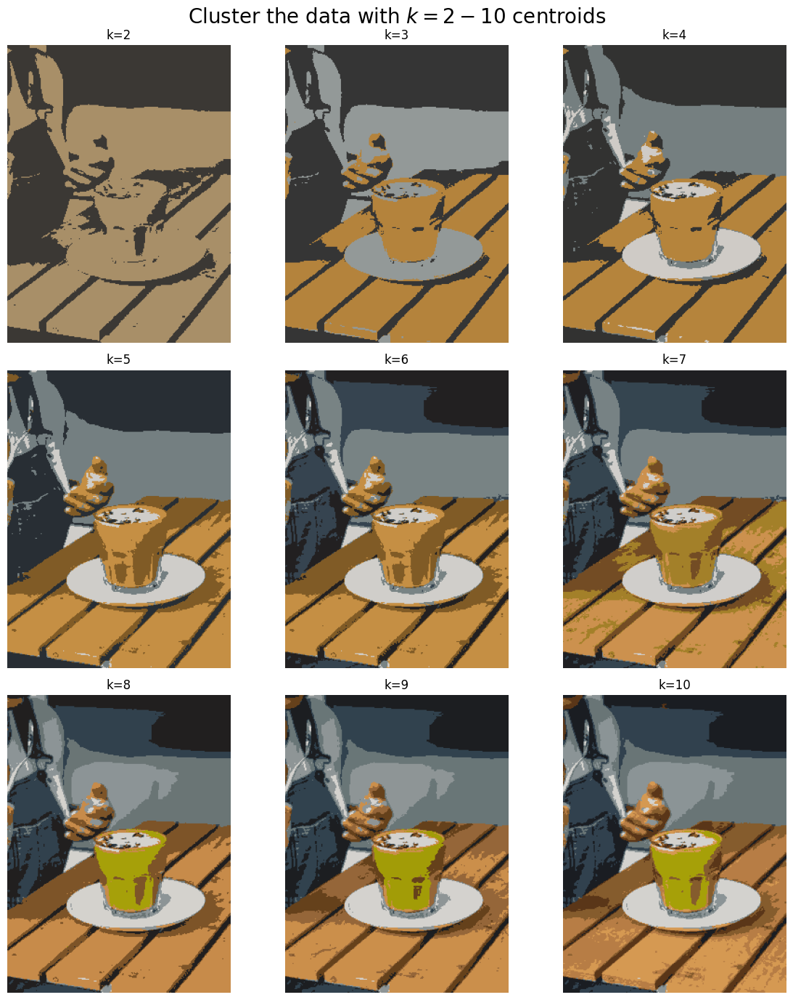

In [26]:
# Helper function to plot image grid
def cluster_image_grid(k, ax, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image on an axis of a figure.

    Args:
      k:    (int)          - Your selected K-value
      ax:   (int)          - Index of the axis of the figure to plot to
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      A new image where each row of img's array has been replaced with the \ 
      coordinates of its nearest centroid. Image is assigned to an axis that \
      can be used in an image grid figure.
    '''
    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters=k, random_state=42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_==i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)
    ax.imshow(new_img)
    ax.axis('off')

fig, axs = plt.subplots(3, 3)
fig.suptitle(r'Cluster the data with $k=2-10$ centroids', size=20)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(12, 14)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=img)
    axs[i].title.set_text('k=' + str(k))

plt.tight_layout()
plt.savefig('output/image_output_k2-10.png')

**Note**: it becomes increasingly difficult to see the difference between the images each time a color is added. This is a visual example of something that happens with all clustering models, even if the data is not an image that you can see. As we group the data into more and more clusters, additional clusters beyond a certain point contribute less and less to the understanding of our data.

